# Document aligner project
## NEW Model Implementation
- U-Net with skip connections
- Flow predictor, differentiable warping
- Standard encoder-decoder

In [1]:
from dataset_loader import get_dataloaders, visualize_batch, visualize_flow_and_warp, visualize_batch_pred
from model import ResNetUnet
from model import MaskedL1Loss, MaskedMSELoss, SSIMLoss, UVReconstructionLoss
from training_val import train_one_epoch, validate

import time 
import os
import glob
from typing import Dict, List, Tuple, Optional, Callable
from pathlib import Path

import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, random_split
from torchvision import transforms
from PIL import Image
import numpy as np


/home/daniel-choate/miniconda3/envs/cvf25/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# Create dataloaders
train_loader, val_loader = get_dataloaders(
    data_dir='/home/daniel-choate/Datasets/DocUnwarp/renders/synthetic_data_pitch_sweep',
    batch_size=8,
    train_split=0.8,
    img_size=(512, 512), #(256, 256)
)

# Visualize samples
sample_batch = next(iter(train_loader))
# visualize_batch(sample_batch, num_samples=4)

Found 2486 samples in /home/daniel-choate/Datasets/DocUnwarp/renders/synthetic_data_pitch_sweep
Train samples: 1988, Val samples: 498


## Training Loop

In [8]:
# Main training loop 

def main():
    """
    Main training loop 
    """
    
    # Configuration
    DATA_DIR = '/home/daniel-choate/Datasets/DocUnwarp/renders/synthetic_data_pitch_sweep'
    BATCH_SIZE = 8
    NUM_EPOCHS = 50
    LEARNING_RATE = 1e-4
    IMG_SIZE = (512, 512) # (512, 512) Using smaller images for faster training for now

    # Set device 
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print(f"Using device: {device}")

    # Create dataloaders
    train_loader, val_loader = get_dataloaders(
        data_dir=DATA_DIR,
        batch_size=BATCH_SIZE,
        img_size=IMG_SIZE,
        use_depth=False, # TODO: True if using depth info
        use_uv=True, # TODO: True if using UV maps
        use_border=True # TODO: True if using border masks for better training
    )

    # Create model
    # model = DocumentReconstructionModel().to(device)
    model = ResNetUnet(
        backbone_name='resnet34',
        pretrained=True
    ).to(device)
    print(f"\nModel parameters: {sum(p.numel() for p in model.parameters()):,}")
    
    # Visualize a batch (testing)
    sample_batch = next(iter(train_loader))
    print(f"Batch RGB shape: {sample_batch['rgb'].shape}")
    print(f"Batch GT shape: {sample_batch['ground_truth'].shape}")
    if 'border' in sample_batch:
        print(f"Batch border mask shape: {sample_batch['border'].shape}")
    if 'uv' in sample_batch:
        print(f"Batch UV shape: {sample_batch['uv'].shape}")
    # visualize_batch(sample_batch)  # Optional visualization
    visualize_flow_and_warp(model, sample_batch, device, num_samples=4)


    # Option 4: Combined loss with UV supervision 
    # NOTE: need to set use_uv = True, use_border = True, 
    criterion = UVReconstructionLoss(
        reconstruction_weight=1.0,
        uv_weight=0.0, # Turning off for now 
        smoothness_weight=0.01, 
        use_mask=True,
        loss_type='ssim' # Use SSIM for geometric recon
    )

    # TODO: TRY DIFFERENT OPTIMIZERS
    # optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)
    optimizer = torch.optim.AdamW(model.parameters(), lr=LEARNING_RATE, weight_decay=0.01)

    # Training loop
    best_val_loss = float('inf')
    train_losses = []
    val_losses = []

    for epoch in range(NUM_EPOCHS):
        # Epoch timing check
        start_epoch = time.time()
        
        print(f"\n{'='*50}")
        print(f"EPOCH {epoch+1}/{NUM_EPOCHS}")
        print(f"{'='*50}")

        # TRAIN 
        train_loss = train_one_epoch(model, train_loader, criterion, optimizer, device, epoch)
        print(f"Train loss: {train_loss:.4f}")
        train_losses.append(train_loss)

        # VALIDATE 
        val_loss = validate(model, val_loader, criterion, device)
        print(f"Val Loss: {val_loss:.4f}")
        val_losses.append(val_loss)
        torch.save({
            'epoch': epoch,
            'train_losses': train_losses,
            'val_losses': val_losses
        }, 'training_history.pth')

        if (epoch + 1) % 5 == 0:
            model.eval()
            with torch.no_grad():
                sample_batch = next(iter(val_loader))

                
                rgb = sample_batch['rgb'].to(device)
                outputs = model(rgb, predict_uv=False)


                # # MASK SANITY CHECK
                # rgb_single = sample_batch['rgb'][0].cpu()       # [3, H, W]
                # border_single = sample_batch['border'][0].cpu() # [1, H, W]

                # mean = torch.tensor([0.485, 0.456, 0.406]).view(3,1,1)
                # std  = torch.tensor([0.229, 0.224, 0.225]).view(3,1,1)
                # rgb_vis = torch.clamp(rgb_single * std + mean, 0, 1)  # [3, H, W]

                # rgb_np  = rgb_vis.permute(1,2,0).numpy()              # [H, W, 3]
                # mask_np = border_single.squeeze(0).numpy()            # [H, W]

                # plt.figure(figsize=(12,4))
                # plt.subplot(1,3,1); plt.imshow(rgb_np); plt.title("RGB"); plt.axis("off")
                # plt.subplot(1,3,2); plt.imshow(mask_np, cmap="gray"); plt.title("Raw mask"); plt.axis("off")
                # plt.subplot(1,3,3); plt.imshow(rgb_np); plt.imshow(mask_np, cmap="jet", alpha=0.3); plt.title("Overlay"); plt.axis("off")
                # plt.show()

                batch_vis = {
                    'rgb': sample_batch['rgb'],
                    'ground_truth': sample_batch['ground_truth'],
                    'predicted': outputs['warped'].cpu()
                }
    
                print(f"\n[Visualization] Epoch {epoch+1}")
                visualize_batch_pred(batch_vis, num_samples=4)
                visualize_flow_and_warp(model, sample_batch, device, num_samples=4)

        # Save the best model 
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            torch.save(model.state_dict(), 'best_model.pth')
            print(f"Saved best model with val loss {val_loss:.4f}")

        epoch_time = time.time() - start_epoch
        print(f"Epoch time: {epoch_time:.4f}s")

    print("\nTraining complete!")
    print(f"Best validation loss: {best_val_loss:.4f}")


    # Loss curve 
    epochs = range(1, NUM_EPOCHS + 1)

    plt.figure(figsize=(8, 5))
    plt.plot(epochs, train_losses, label='Train Loss')
    plt.plot(epochs, val_losses, label='Validation Loss')

    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training & Validation Loss Curve')
    plt.legend()
    plt.grid(True)

    plt.tight_layout()
    plt.show()
    

Document Reconstruction Dataset Loader
Found 2486 samples in /home/daniel-choate/Datasets/DocUnwarp/renders/synthetic_data_pitch_sweep
Train samples: 1988, Val samples: 498

Dataset loaded successfully!
Using device: cuda
Found 2486 samples in /home/daniel-choate/Datasets/DocUnwarp/renders/synthetic_data_pitch_sweep
Train samples: 1988, Val samples: 498

Model parameters: 24,298,884

Loading training history from training_history.pth ...
History found: last finished epoch = 27, resuming from epoch 28
Loading model weights from best_model.pth ...
Loaded best model weights.


/tmp/ipykernel_4927/2881316950.py:63: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  hist = torch.load(HISTORY_PATH, map_location=device)
/tmp/ipykernel_4927/2881316950.py:79

Batch RGB shape: torch.Size([8, 3, 512, 512])
Batch GT shape: torch.Size([8, 3, 512, 512])
Batch border mask shape: torch.Size([8, 1, 512, 512])
Batch UV shape: torch.Size([8, 3, 512, 512])


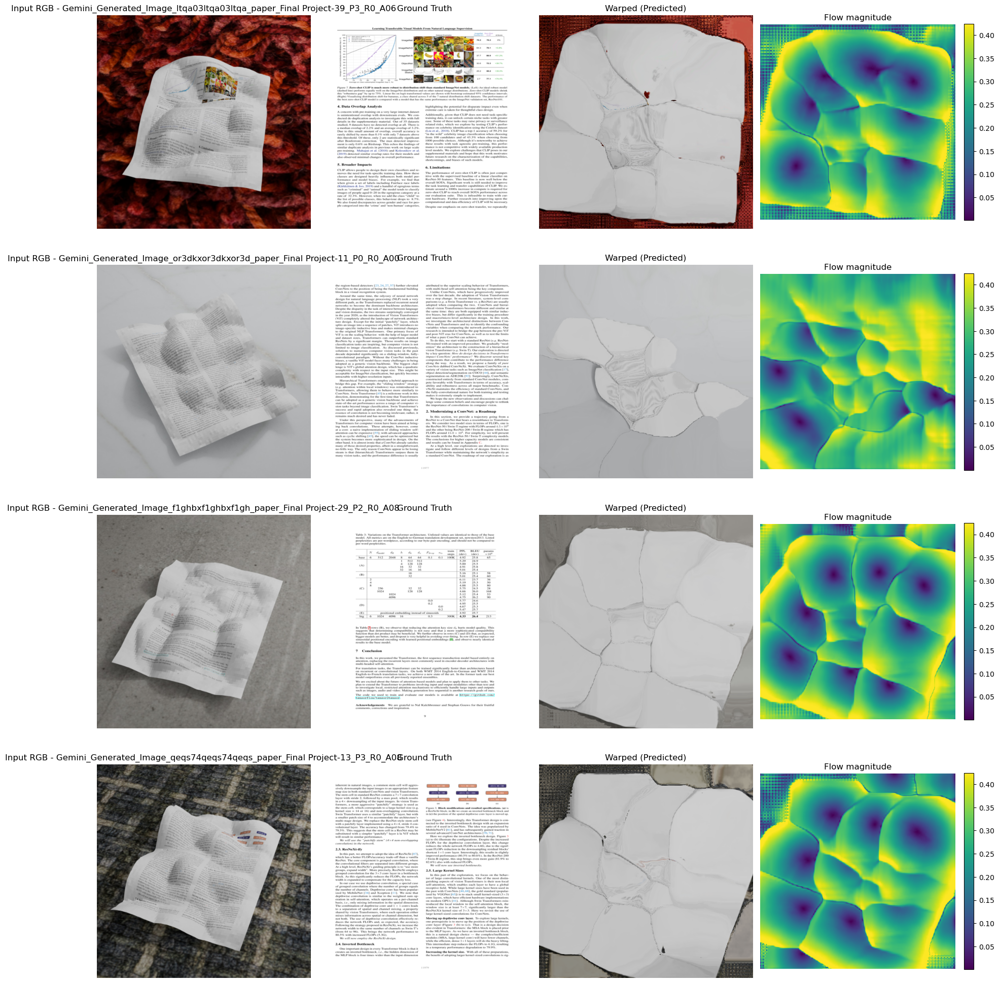


EPOCH 29/50
Train loss: 0.4968
Val Loss: 0.4930
Saved best model with val loss 0.4930
Epoch time: 193.1308s

EPOCH 30/50
Train loss: 0.4959
Val Loss: 0.4927

[Visualization] Epoch 30


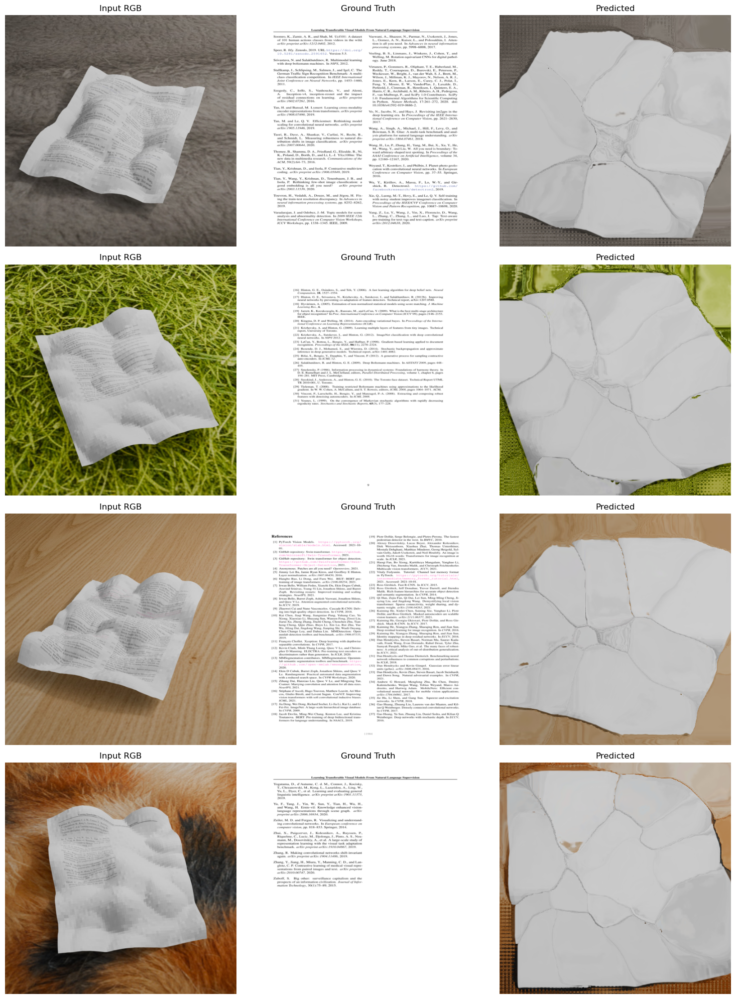

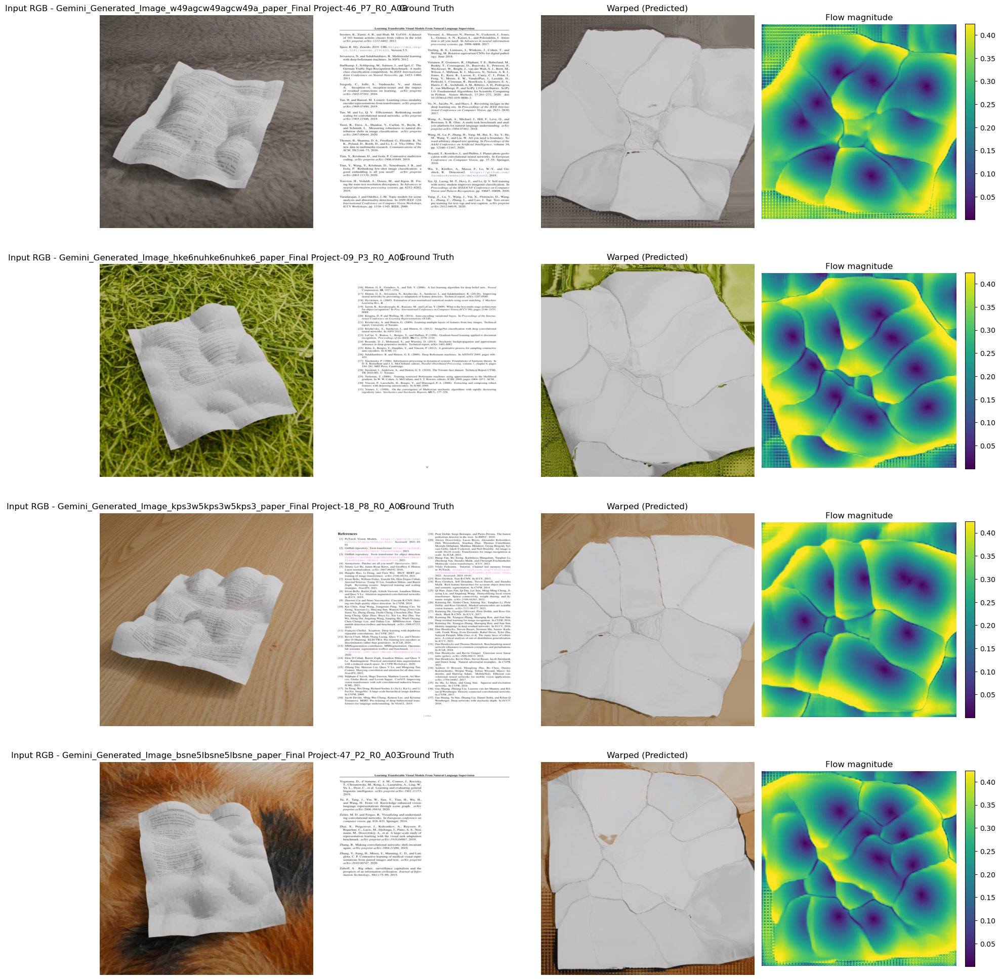

Saved best model with val loss 0.4927
Epoch time: 198.4254s

EPOCH 31/50
Train loss: 0.4952
Val Loss: 0.4923
Saved best model with val loss 0.4923
Epoch time: 190.9310s

EPOCH 32/50
Train loss: 0.4945
Val Loss: 0.4907
Saved best model with val loss 0.4907
Epoch time: 192.0931s

EPOCH 33/50
Train loss: 0.4940
Val Loss: 0.4906
Saved best model with val loss 0.4906
Epoch time: 192.1225s

EPOCH 34/50
Train loss: 0.4931
Val Loss: 0.4898
Saved best model with val loss 0.4898
Epoch time: 192.6213s

EPOCH 35/50
Train loss: 0.4926
Val Loss: 0.4888

[Visualization] Epoch 35


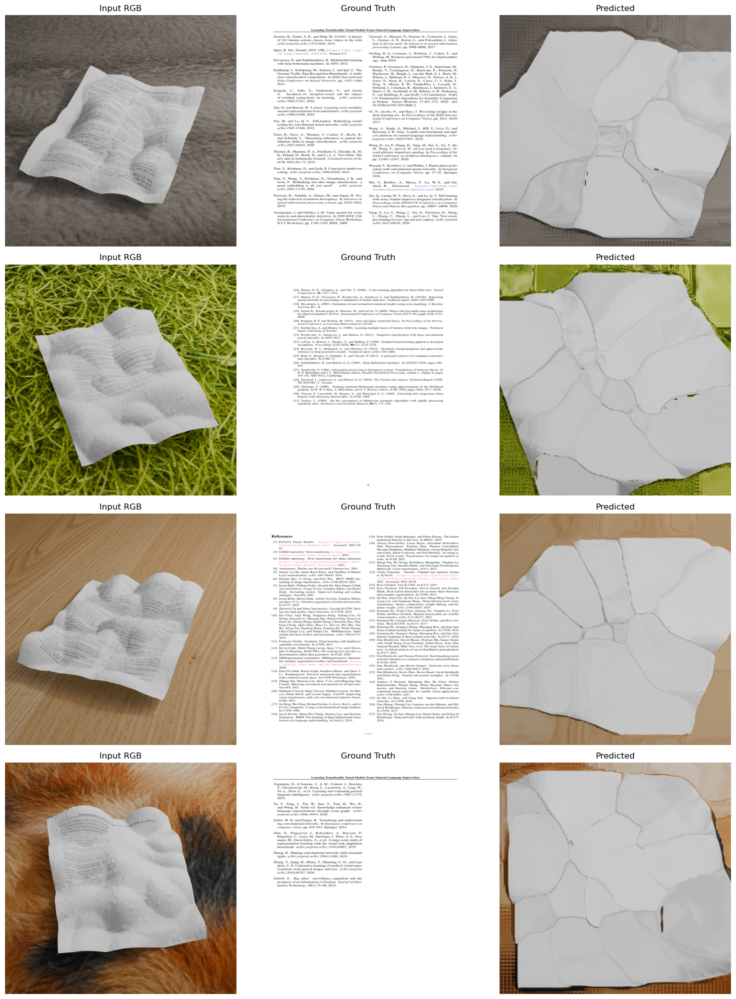

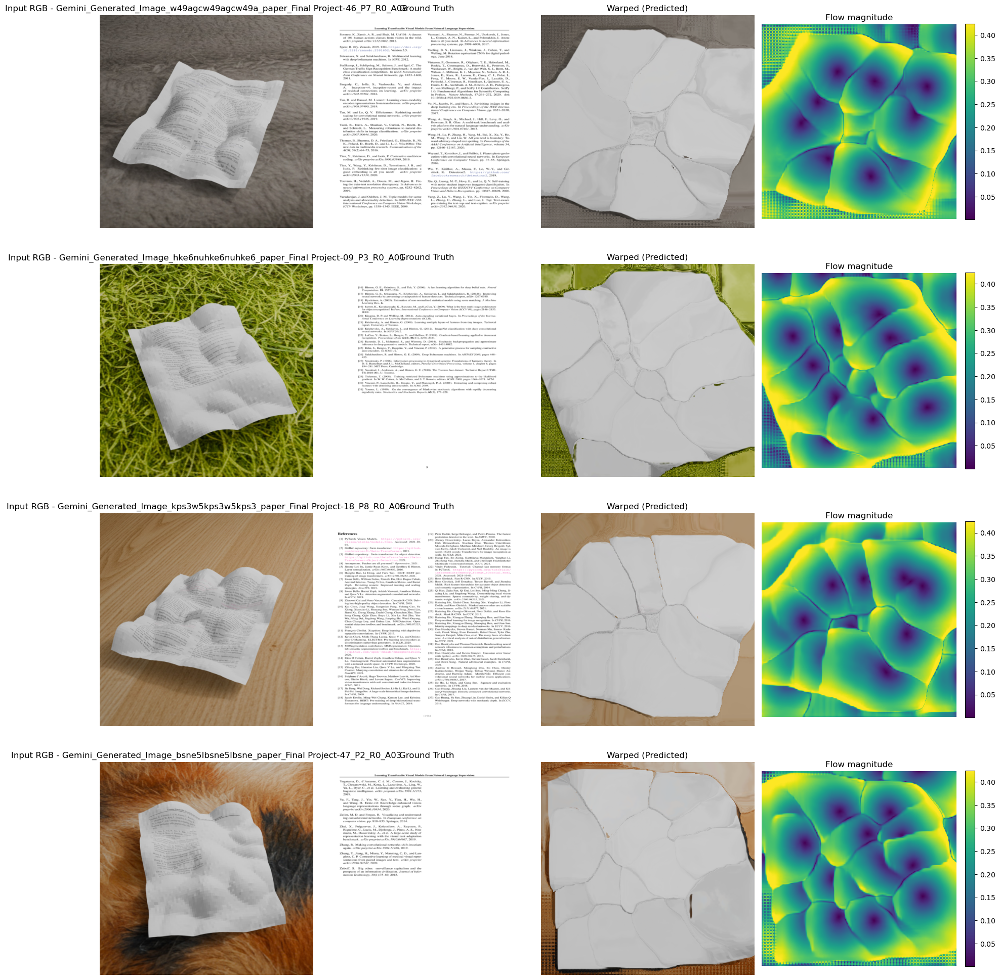

Saved best model with val loss 0.4888
Epoch time: 199.9402s

EPOCH 36/50
Train loss: 0.4919
Val Loss: 0.4888
Saved best model with val loss 0.4888
Epoch time: 192.6371s

EPOCH 37/50
Train loss: 0.4917
Val Loss: 0.4905
Epoch time: 193.6572s

EPOCH 38/50
Train loss: 0.4905
Val Loss: 0.4880
Saved best model with val loss 0.4880
Epoch time: 194.5835s

EPOCH 39/50
Train loss: 0.4907
Val Loss: 0.4878
Saved best model with val loss 0.4878
Epoch time: 193.2907s

EPOCH 40/50
Train loss: 0.4899
Val Loss: 0.4862

[Visualization] Epoch 40


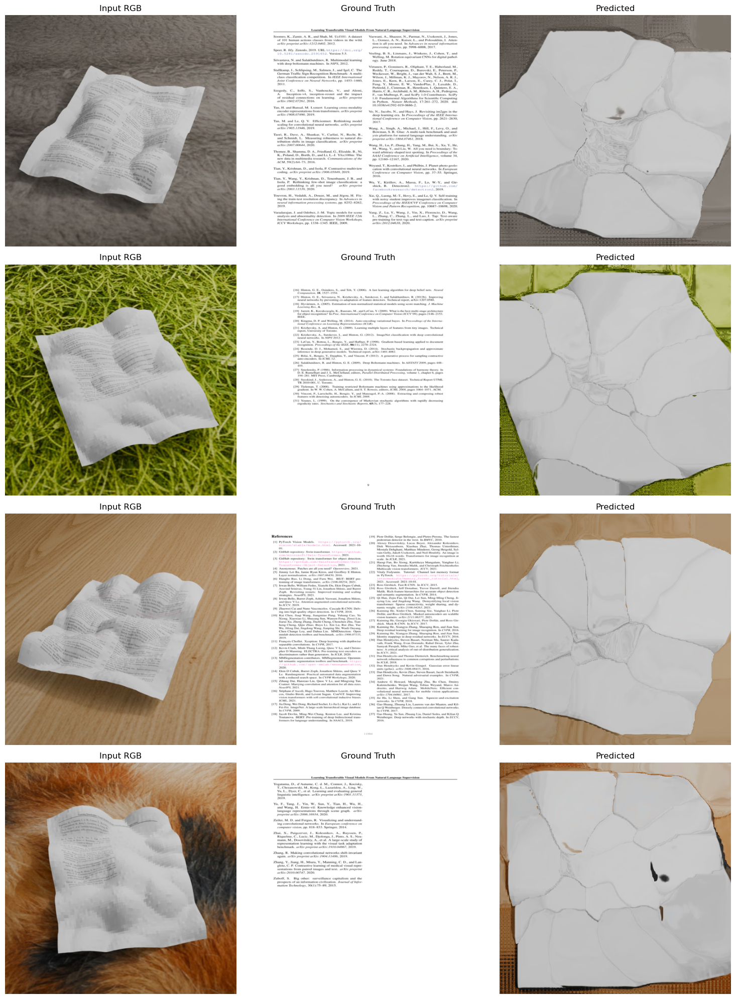

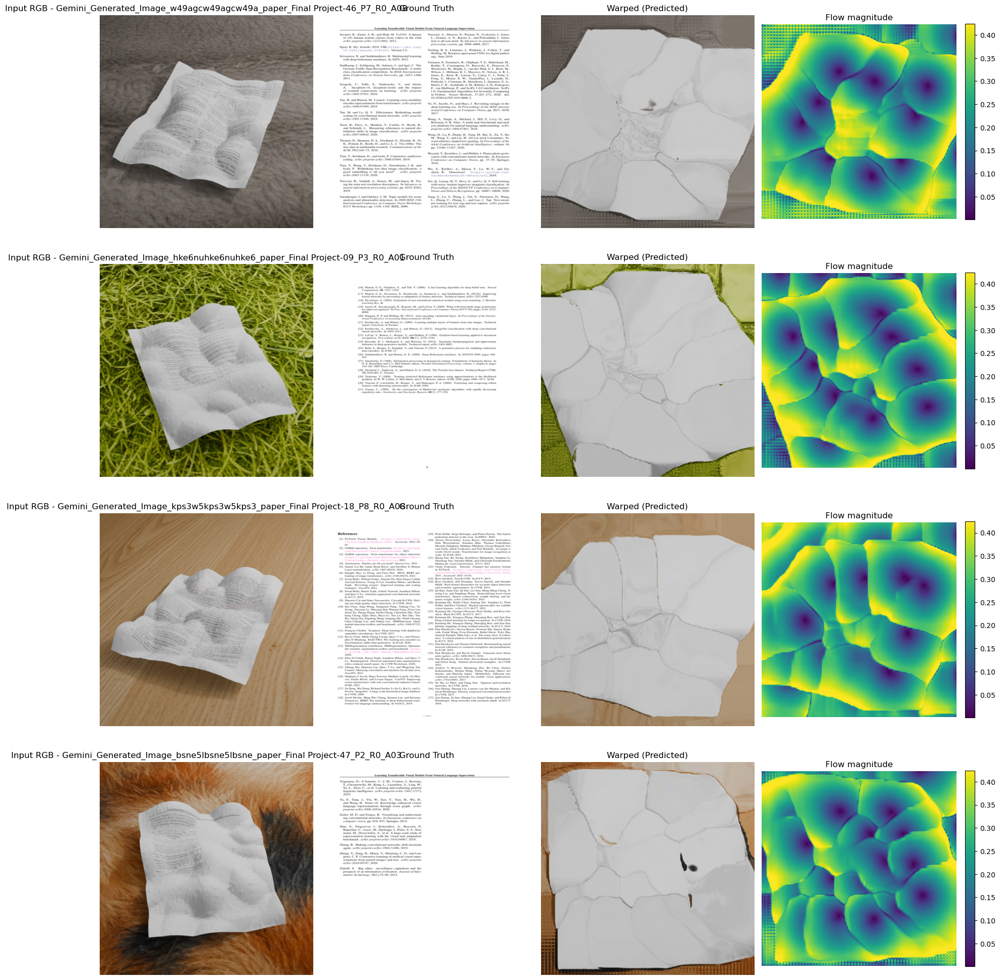

Saved best model with val loss 0.4862
Epoch time: 200.9764s

EPOCH 41/50
Train loss: 0.4888
Val Loss: 0.4862
Epoch time: 191.3016s

EPOCH 42/50
Train loss: 0.4886
Val Loss: 0.4863
Epoch time: 191.5259s

EPOCH 43/50
Train loss: 0.4881
Val Loss: 0.4854
Saved best model with val loss 0.4854
Epoch time: 191.1308s

EPOCH 44/50
Train loss: 0.4873
Val Loss: 0.4860
Epoch time: 191.1240s

EPOCH 45/50
Train loss: 0.4880
Val Loss: 0.4844

[Visualization] Epoch 45


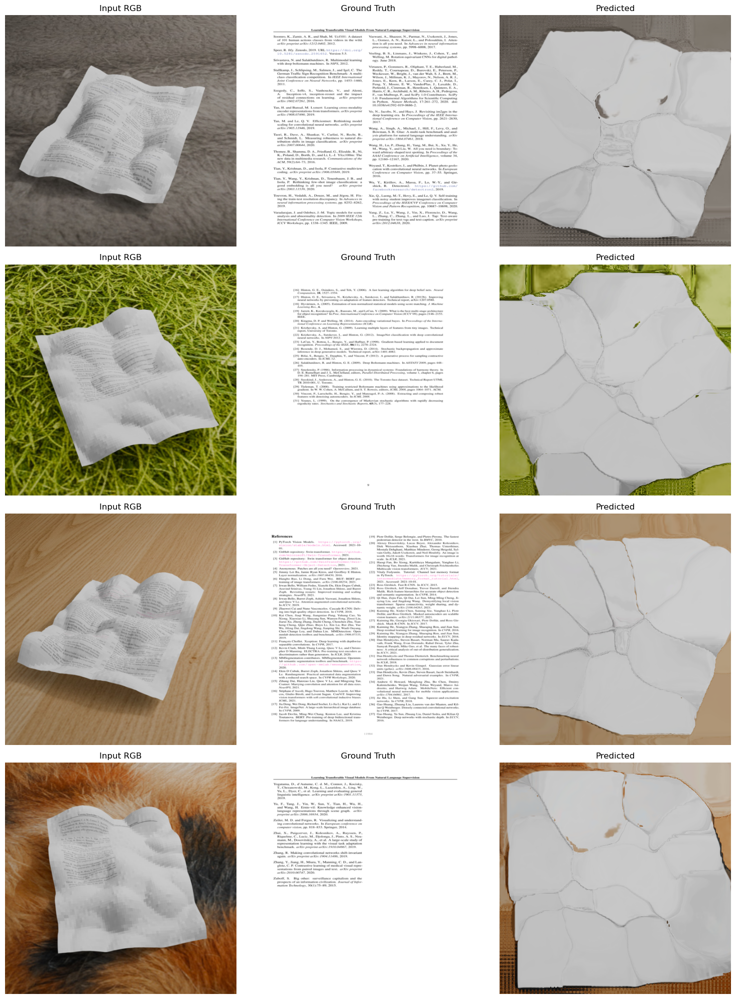

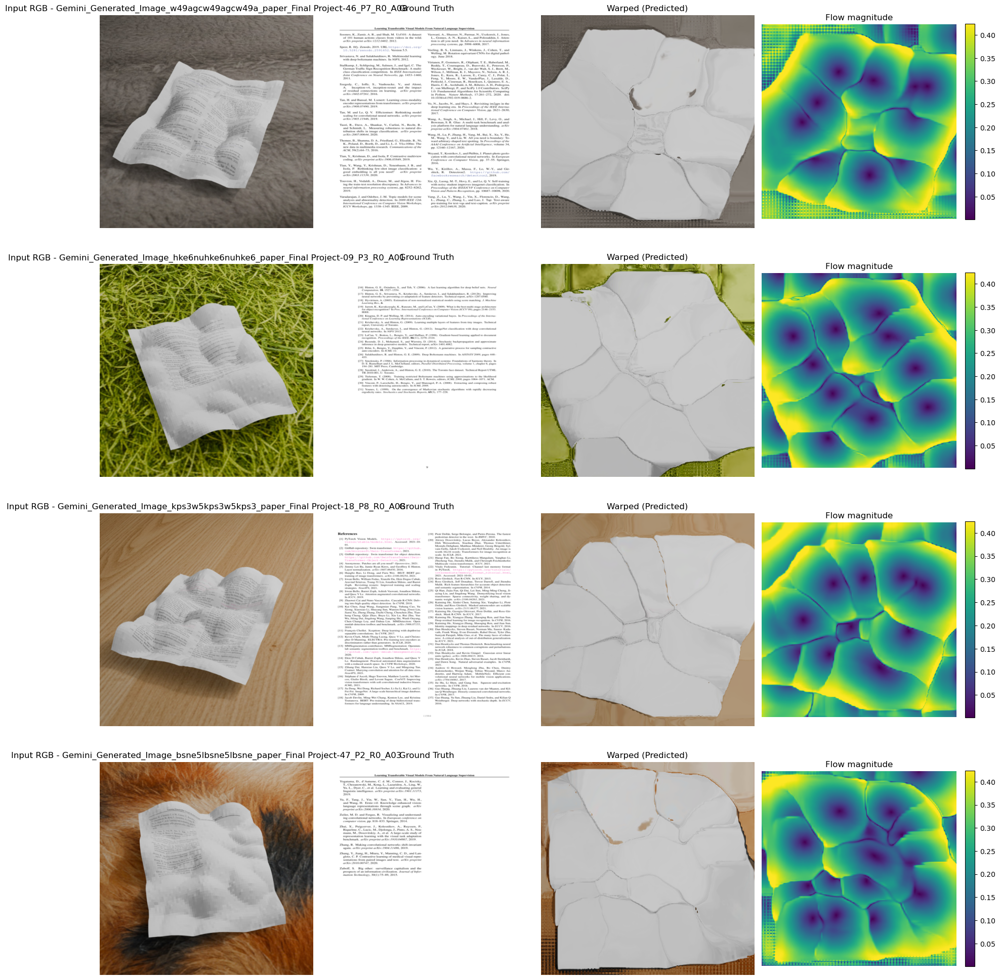

Saved best model with val loss 0.4844
Epoch time: 198.5761s

EPOCH 46/50
Train loss: 0.4872
Val Loss: 0.4846
Epoch time: 191.3532s

EPOCH 47/50
Train loss: 0.4863
Val Loss: 0.4852
Epoch time: 190.8487s

EPOCH 48/50
Train loss: 0.4861
Val Loss: 0.4835
Saved best model with val loss 0.4835
Epoch time: 191.0432s

EPOCH 49/50
Train loss: 0.4858
Val Loss: 0.4828
Saved best model with val loss 0.4828
Epoch time: 190.9630s

EPOCH 50/50
Train loss: 0.4854
Val Loss: 0.4823

[Visualization] Epoch 50


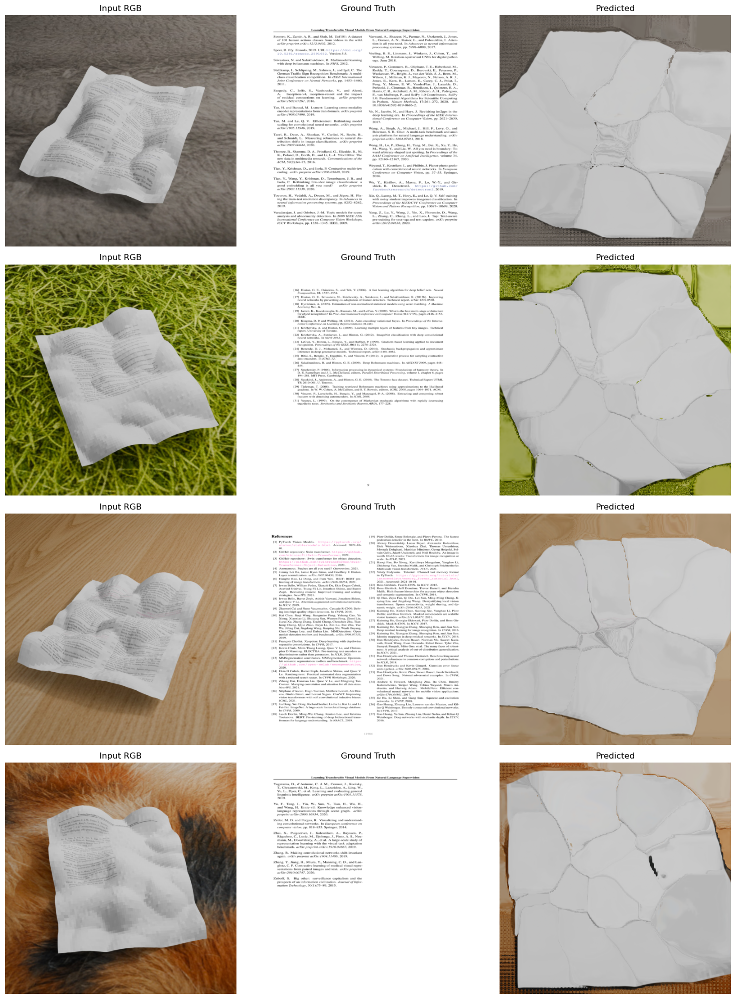

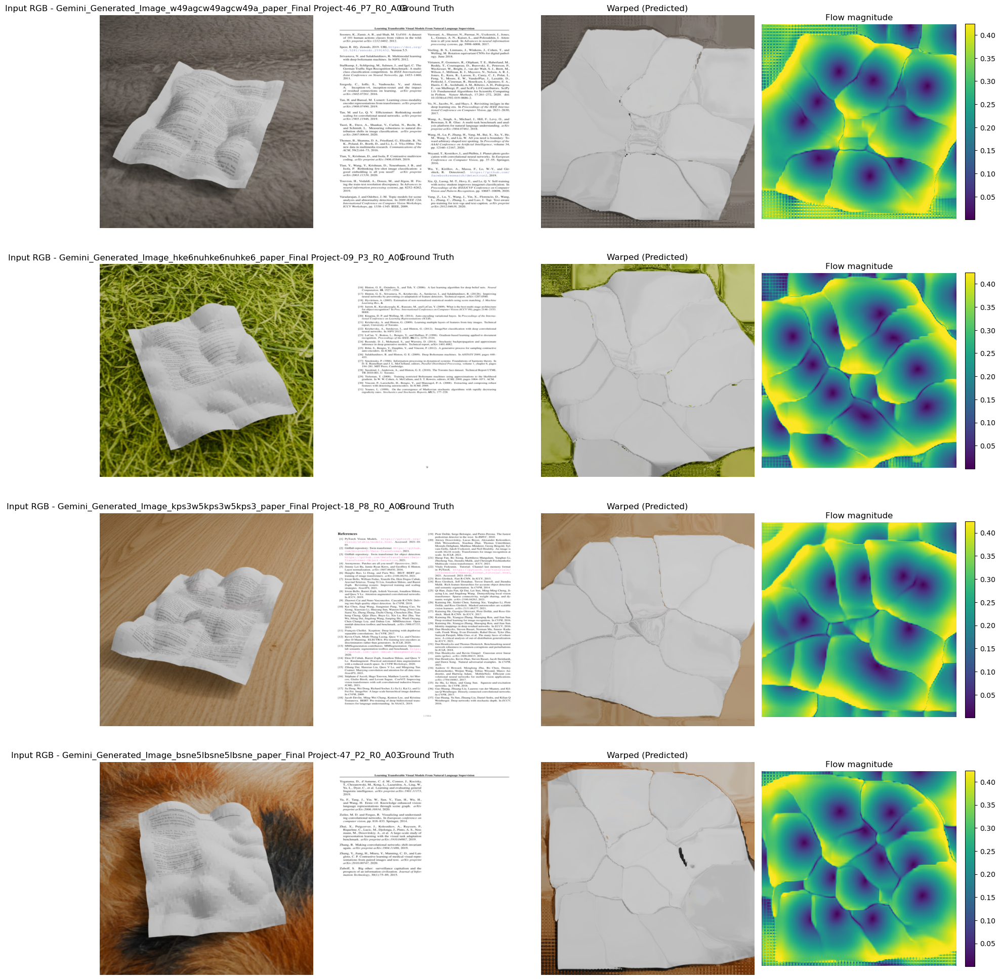

Saved best model with val loss 0.4823
Epoch time: 197.9884s

Training complete!
Best validation loss: 0.4823


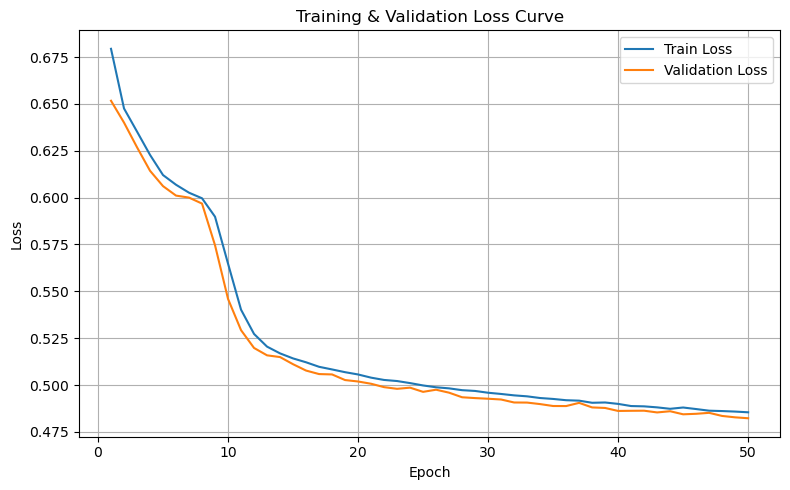

In [4]:
# Execute main 

print("Document Reconstruction Dataset Loader")
print("="*50)

# Quick test 
train_loader, val_loader = get_dataloaders(
    data_dir = '/home/daniel-choate/Datasets/DocUnwarp/renders/synthetic_data_pitch_sweep',
    batch_size = 4, 
    img_size=(256, 256) # (512,512)
)

print("\nDataset loaded successfully!")

# # Visualize sample batch 
# print("\nVisualizing a sample batch ...")
# sample_batch = next(iter(train_loader))
# print(f"Batch shape - RGB: {sample_batch['rgb'].shape}, Ground Truth: {sample_batch['ground_truth'].shape}")
# visualize_batch(sample_batch, num_samples=min(4, sample_batch['rgb'].shape[0]))

# Main training loop 
main()

/tmp/ipykernel_4927/4074148250.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  history = torch.load('training_history_512.pth')


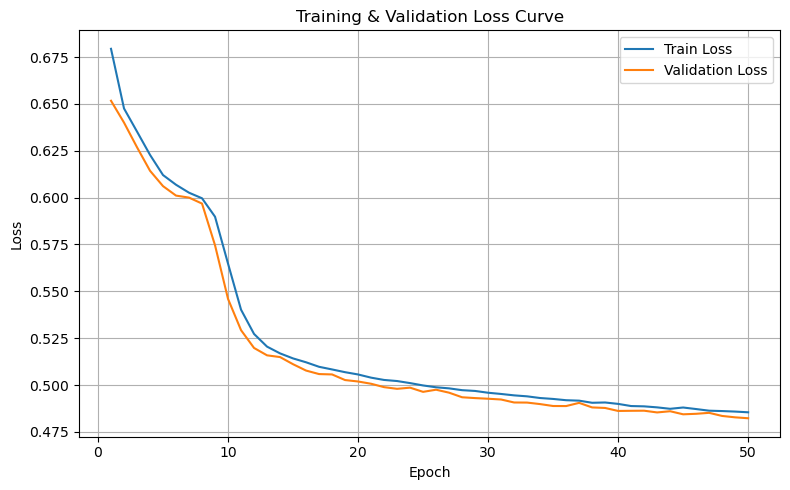

In [9]:
# Loss plot 
import matplotlib.pyplot as plt

history = torch.load('training_history_512.pth')

train_losses = history['train_losses']
val_losses = history['val_losses']
epochs = range(1, 50 + 1)

plt.figure(figsize=(8, 5))
plt.plot(epochs, train_losses, label='Train Loss')
plt.plot(epochs, val_losses, label='Validation Loss')

plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training & Validation Loss Curve')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()